In [ ]:
import numpy as np
import tensorflow as tf
import cv2
import matplotlib.pyplot as plt
import zipfile
import os
import time
import matplotlib.image as mpimg
%matplotlib inline


In [ ]:
#!kaggle datasets download -d jangedoo/utkface-new
#!unzip -q utkface-new.zip

In [ ]:
!ls UTKFace

Streaming output truncated to the last 5000 lines.
 26_0_2_20170116184103544.jpg	  52_0_3_20170113184200775.jpg
 26_0_2_20170116184137536.jpg	  52_0_3_20170113190623929.jpg
 26_0_2_20170116184500032.jpg	  52_0_3_20170117190840617.jpg
 26_0_2_20170116184700065.jpg	  52_0_3_20170119160357804.jpg
 26_0_2_20170116184721092.jpg	  52_0_3_20170119181010188.jpg
 26_0_2_20170116210411437.jpg	  52_0_3_20170119200211340.jpg
 26_0_2_20170116233100347.jpg	  52_0_3_20170119200241996.jpg
 26_0_2_20170117172558276.jpg	  52_0_3_20170119200259595.jpg
 26_0_2_20170117172618124.jpg	  52_0_3_20170119200407188.jpg
 26_0_2_20170117172630501.jpg	  52_0_3_20170119204331863.jpg
 26_0_2_20170117172714981.jpg	  52_0_3_20170119204337838.jpg
 26_0_2_20170117172733502.jpg	  52_0_3_20170119205638160.jpg
 26_0_2_20170117201336782.jpg	  52_0_3_20170119205639336.jpg
 26_0_2_20170119180202654.jpg	  52_0_3_20170119205641007.jpg
 26_0_2_20170119180632923.jpg	  52_0_3_20170119205647136.jpg
 26_0_2_20170119184042373.jpg	  52

In [ ]:


directory = '/content/UTKFace'  # Replace with your directory

for filename in os.listdir(directory):
  if filename.endswith(".jpg.chip.jpg"):
        new_filename = filename.replace(".jpg.chip.jpg", ".jpg")
        os.rename(os.path.join(directory, filename), os.path.join(directory, new_filename))

In [ ]:
!ls UTKFace

Streaming output truncated to the last 5000 lines.
 26_0_2_20170116184103544.jpg	  52_0_3_20170113184200775.jpg
 26_0_2_20170116184137536.jpg	  52_0_3_20170113190623929.jpg
 26_0_2_20170116184500032.jpg	  52_0_3_20170117190840617.jpg
 26_0_2_20170116184700065.jpg	  52_0_3_20170119160357804.jpg
 26_0_2_20170116184721092.jpg	  52_0_3_20170119181010188.jpg
 26_0_2_20170116210411437.jpg	  52_0_3_20170119200211340.jpg
 26_0_2_20170116233100347.jpg	  52_0_3_20170119200241996.jpg
 26_0_2_20170117172558276.jpg	  52_0_3_20170119200259595.jpg
 26_0_2_20170117172618124.jpg	  52_0_3_20170119200407188.jpg
 26_0_2_20170117172630501.jpg	  52_0_3_20170119204331863.jpg
 26_0_2_20170117172714981.jpg	  52_0_3_20170119204337838.jpg
 26_0_2_20170117172733502.jpg	  52_0_3_20170119205638160.jpg
 26_0_2_20170117201336782.jpg	  52_0_3_20170119205639336.jpg
 26_0_2_20170119180202654.jpg	  52_0_3_20170119205641007.jpg
 26_0_2_20170119180632923.jpg	  52_0_3_20170119205647136.jpg
 26_0_2_20170119184042373.jpg	  52

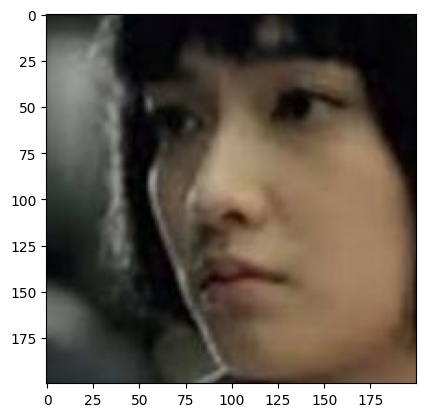

In [ ]:
img = cv2.imread('/content/UTKFace/26_1_2_20170116180655987.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)

In [ ]:
for dirpath, dirname, filename in os.walk('/content/UTKFace'):
  print(f"There are {len(dirname)} directories and {len(filename)} images in {dirpath}")

There are 0 directories and 23708 images in /content/UTKFace


In [ ]:
!ls /content/utkface_aligned_cropped/crop_part1

10_0_0_20161220222308131.jpg.chip.jpg	32_1_0_20170104234949266.jpg.chip.jpg
10_0_0_20170103200329407.jpg.chip.jpg	32_1_0_20170104235611258.jpg.chip.jpg
10_0_0_20170103200522151.jpg.chip.jpg	32_1_0_20170105002717213.jpg.chip.jpg
10_0_0_20170103233459275.jpg.chip.jpg	32_1_0_20170105161518546.jpg.chip.jpg
10_0_0_20170104013211746.jpg.chip.jpg	32_1_0_20170105162332267.jpg.chip.jpg
10_0_0_20170110215927291.jpg.chip.jpg	32_1_0_20170105162521931.jpg.chip.jpg
10_0_0_20170110220033115.jpg.chip.jpg	32_1_0_20170105163404036.jpg.chip.jpg
10_0_0_20170110220111082.jpg.chip.jpg	32_1_0_20170105164152987.jpg.chip.jpg
10_0_0_20170110220235233.jpg.chip.jpg	32_1_0_20170105173150717.jpg.chip.jpg
10_0_0_20170110220251986.jpg.chip.jpg	32_1_0_20170108224936101.jpg.chip.jpg
10_0_0_20170110220255346.jpg.chip.jpg	32_1_0_20170109003522801.jpg.chip.jpg
10_0_0_20170110220316298.jpg.chip.jpg	32_1_0_20170109004650365.jpg.chip.jpg
10_0_0_20170110220403810.jpg.chip.jpg	32_1_0_20170109132836606.jpg.chip.jpg
10_0_0_20170

In [ ]:
for dirpath, dirname, filename in os.walk('/content/utkface_aligned_cropped/crop_part1'):
  print(f"There are {len(dirname)} directories and {len(filename)} images in {dirpath}")

There are 0 directories and 9780 images in /content/utkface_aligned_cropped/crop_part1


In [ ]:
img_directory = '/content/UTKFace'

for dirpath, dirname, filenames in os.walk(img_directory):
  count = 0
  for filename in filenames:
    count += 1
    if count > 10:
      break
    print(filename)

33_0_0_20170108224634529.jpg
27_1_4_20170103210539730.jpg
25_1_0_20170117152038451.jpg
55_1_0_20170117092223899.jpg
26_1_2_20170116180753524.jpg
29_1_0_20170104192921991.jpg
26_0_3_20170119180456692.jpg
36_0_3_20170119201943645.jpg
26_1_0_20170117153116669.jpg
24_1_2_20170116170612853.jpg


In [ ]:
import pandas as pd
import csv

In [ ]:
header = ['Fname', 'Age', 'Sex', 'Ethinicity']
fname = 'face_data.csv'
with open(fname, 'w') as f:
  writer = csv.writer(f)
  writer.writerow(header)
  for dirpath, dirname, filenames in os.walk('/content/UTKFace'):
    for filename in filenames:
      arr = []
      arr.append(filename)
      features = filename.split('_')
      arr.append(np.float32(features[0]))
      arr.append(np.float32(features[1]))
      if features[2].endswith('.jpg'):
        continue
      arr.append(np.float32(features[2]))
      writer.writerow(arr)

  print('Done')

Done


In [ ]:
data = pd.read_csv('face_data.csv')
data.head()

,Fname,Age,Sex,Ethinicity
0,33_0_0_20170108224634529.jpg,33.0,0.0,0.0
1,27_1_4_20170103210539730.jpg,27.0,1.0,4.0
2,25_1_0_20170117152038451.jpg,25.0,1.0,0.0
3,55_1_0_20170117092223899.jpg,55.0,1.0,0.0
4,26_1_2_20170116180753524.jpg,26.0,1.0,2.0


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23705 entries, 0 to 23704
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Fname       23705 non-null  object 
 1   Age         23705 non-null  float64
 2   Sex         23705 non-null  float64
 3   Ethinicity  23705 non-null  float64
dtypes: float64(3), object(1)
memory usage: 740.9+ KB


In [ ]:
from sklearn.preprocessing import OneHotEncoder


encoder = OneHotEncoder(sparse=False)
categorical_columns = ['Ethinicity']
encoded_data = encoder.fit_transform(data[categorical_columns])
encoded_columns = encoder.get_feature_names_out(categorical_columns)
encoded_df = pd.DataFrame(encoded_data, columns=encoded_columns)
data = data.drop(categorical_columns, axis=1)
data = pd.concat([data, encoded_df], axis=1)

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


In [ ]:
data.head()

,Fname,Age,Sex,Ethinicity_0.0,Ethinicity_1.0,Ethinicity_2.0,Ethinicity_3.0,Ethinicity_4.0
0,33_0_0_20170108224634529.jpg,33.0,0.0,1.0,0.0,0.0,0.0,0.0
1,27_1_4_20170103210539730.jpg,27.0,1.0,0.0,0.0,0.0,0.0,1.0
2,25_1_0_20170117152038451.jpg,25.0,1.0,1.0,0.0,0.0,0.0,0.0
3,55_1_0_20170117092223899.jpg,55.0,1.0,1.0,0.0,0.0,0.0,0.0
4,26_1_2_20170116180753524.jpg,26.0,1.0,0.0,0.0,1.0,0.0,0.0


In [ ]:
data = data.rename(columns={'Ethinicity_0.0': 'White', 'Ethinicity_1.0': 'Black', 'Ethinicity_2.0': 'Asian', 'Ethinicity_3.0': 'Indian', 'Ethinicity_4.0': 'Others'})

In [ ]:
data.head()

,Fname,Age,Sex,White,Black,Asian,Indian,Others
0,33_0_0_20170108224634529.jpg,33.0,0.0,1.0,0.0,0.0,0.0,0.0
1,27_1_4_20170103210539730.jpg,27.0,1.0,0.0,0.0,0.0,0.0,1.0
2,25_1_0_20170117152038451.jpg,25.0,1.0,1.0,0.0,0.0,0.0,0.0
3,55_1_0_20170117092223899.jpg,55.0,1.0,1.0,0.0,0.0,0.0,0.0
4,26_1_2_20170116180753524.jpg,26.0,1.0,0.0,0.0,1.0,0.0,0.0


In [ ]:
X = []
INPUT_SHAPE = (224, 224, 3)
count = 0

for index, row in data.iterrows():
    count += 1
    if count > (23705 // 10):
      break
    image_path = '/content/UTKFace/' + row['Fname']
    image = cv2.imread(image_path)
    image = cv2.resize(image, INPUT_SHAPE[:2])

    X.append(image)

import numpy as np

X = np.array(X)
X = X / 255.0
X = X.astype('float32')
'''midpoint = len(X) // 4

# Get the first half
X_h = X[:midpoint]
'''
y = data.drop(['Fname'], axis=1)

y = np.array(y)
midpoint = len(y) // 10

# Get the first half
y_h = y[:midpoint]

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y_h, test_size=0.2, random_state=42)



In [ ]:
y[::, 2:].shape

(23705, 5)

In [ ]:
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.layers import Dense, Flatten, Input, LeakyReLU, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

base_model = VGG16(weights='imagenet', include_top=False, input_shape=INPUT_SHAPE)

base_model.trainable = False

input = Input(shape=INPUT_SHAPE)
x = base_model(input)
x = Flatten()(x)
x = Dense(256)(x)
x = LeakyReLU()(x)
x = Dropout(0.2)(x)
output_age = Dense(1, activation='linear', name='output_age')(x)
output_sex = Dense(1, activation='sigmoid', name='output_sex')(x)
output_ethinicity = Dense(5, activation='softmax', name='output_ethinicity')(x)

model = Model(input, [output_age, output_sex, output_ethinicity])

In [ ]:
model.compile(optimizer=Adam(lr=0.001),
              loss={'output_age': 'mse',  # Mean Squared Error for regression
                    'output_sex': 'binary_crossentropy',  # Categorical Cross-Entropy for classification
                    'output_ethinicity': 'categorical_crossentropy'},  # Categorical Cross-Entropy for classification
              metrics={'output_age': 'mae',  # Mean Absolute Error for regression
                       'output_sex': 'accuracy',  # Accuracy for classification
                       'output_ethinicity': 'accuracy'})  # Accuracy for classification)

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 vgg16 (Functional)          (None, 7, 7, 512)            1471468   ['input_2[0][0]']             
                                                          8                                       
                                                                                                  
 flatten (Flatten)           (None, 25088)                0         ['vgg16[0][0]']               
                                                                                                  
 dense (Dense)               (None, 256)                  6422784   ['flatten[0][0]']         

In [ ]:
history = model.fit(X_train,
                    {'output_age': y_train[::, 0],
                     'output_sex': y_train[::, 1],
                     'output_ethinicity': y_train[::, 2:]},
                    epochs=50,
                    #batch_size=100,
                    validation_data=(X_test,
                                     {'output_age': y_test[::, 0],
                                      'output_sex': y_test[::, 1],
                                      'output_ethinicity': y_test[::, 2:]}))

Epoch 1/50
60/60 [==============================] - 35s 364ms/step - loss: 321.7262 - output_age_loss: 317.3208 - output_sex_loss: 1.1522 - output_ethinicity_loss: 3.2532 - output_age_mae: 13.6152 - output_sex_accuracy: 0.5707 - output_ethinicity_accuracy: 0.3017 - val_loss: 202.0592 - val_output_age_loss: 200.0226 - val_output_sex_loss: 0.6941 - val_output_ethinicity_loss: 1.3425 - val_output_age_mae: 10.9830 - val_output_sex_accuracy: 0.5992 - val_output_ethinicity_accuracy: 0.4958
Epoch 2/50
60/60 [==============================] - 10s 174ms/step - loss: 168.1313 - output_age_loss: 164.5238 - output_sex_loss: 1.0272 - output_ethinicity_loss: 2.5803 - output_age_mae: 9.9598 - output_sex_accuracy: 0.6086 - output_ethinicity_accuracy: 0.3729 - val_loss: 170.1737 - val_output_age_loss: 168.5397 - val_output_sex_loss: 0.4204 - val_output_ethinicity_loss: 1.2135 - val_output_age_mae: 9.7745 - val_output_sex_accuracy: 0.7996 - val_output_ethinicity_accuracy: 0.5949
Epoch 3/50
60/60 [======

In [ ]:
save_dir = '/content/drive/My Drive/'

# Save the entire model
model.save(save_dir + '/age_pred_vgg16.h5')


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
def prediction(image):
  image = cv2.resize(image, INPUT_SHAPE[:2])
  image = image / 255.0
  image_tensor = tf.convert_to_tensor(image, dtype=tf.float32)
  image_tensor = tf.expand_dims(image_tensor, axis=0)
  predictions = model.predict(image_tensor)
  return predictions

In [ ]:
imgg = cv2.imread('/content/testimg2.jpg')
age, sex, eth = prediction(imgg)
print(age, sex, eth)

1/1 [==============================] - 0s 26ms/step
[[22.208826]] [[0.94759005]] [[1.2541676e-02 9.7530760e-04 9.8622340e-01 2.3313590e-04 2.6482800e-05]]


In [ ]:

def ethinicity_val(eth):
  mx = -1
  j = -1
  ethin = ''
  for i in range(len(eth[0])):
    if eth[0][i] > mx:
      mx = eth[0][i]
      j = i

  if j == 0:
    ethin = 'White'
  elif j == 1:
    ethin = 'Black'
  elif j == 2:
    ethin = 'Asian'
  elif j == 3:
    ethin = 'Indian'
  elif j == 4:
    ethin = 'Others'

  return ethin

In [ ]:
def sex_val(sex):
  if sex <= 0.5:
    return 'Male'
  else:
    return 'Female'

In [ ]:
face_cascade = cv2.CascadeClassifier('/content/haarcascade_frontalface_default.xml')

In [ ]:
def detect_face(img):


    face_img = img.copy()

    face_rects = face_cascade.detectMultiScale(face_img)


    for (x,y,w,h) in face_rects:
        age, sex, eth = prediction(face_img[x:x+w+1][y:y+h+1])
        agee = str(int(age[0][0]))
        sexe = sex_val(sex)
        ethe = ethinicity_val(eth)
        cv2.rectangle(face_img, (x,y), (x+w,y+h), (0,255,0), 10)
        text = f"{agee}, {sexe}, {ethe}"
        top_left = (x, y)
        bottom_right = (x + w, y + h)
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 0.5
        font_color = (255, 255, 255)
        font_thickness = 1


        text_size, _ = cv2.getTextSize(text, font, font_scale, font_thickness)
        text_x = top_left[0]
        text_y = bottom_right[1] + text_size[1] + 10


        cv2.putText(image, text, (text_x, text_y), font, font_scale, font_color, font_thickness)


    return face_img


yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 64ms/step


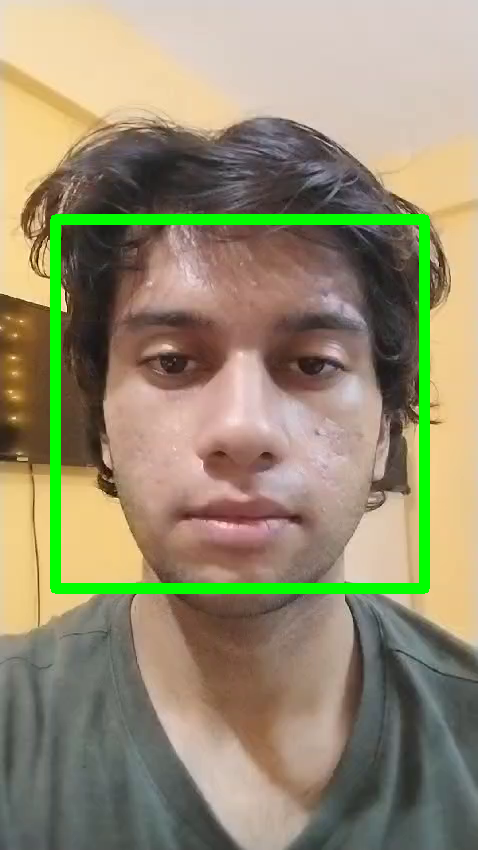

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 25ms/step


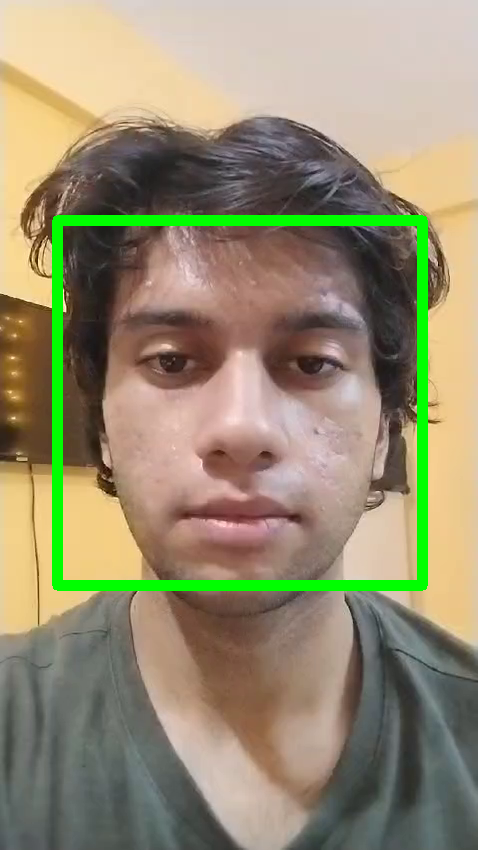

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 43ms/step


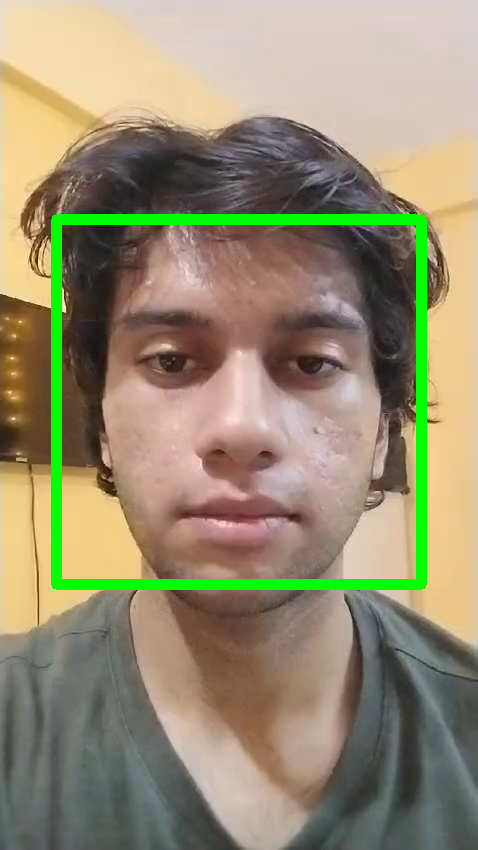

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 37ms/step


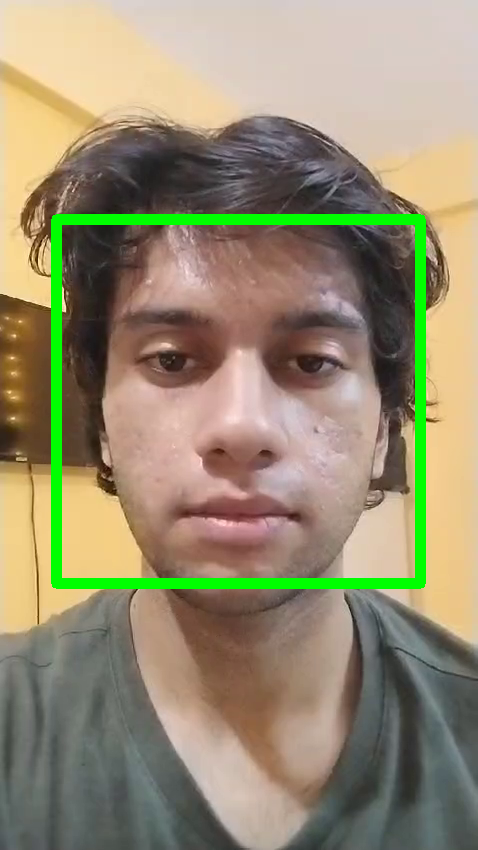

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 27ms/step


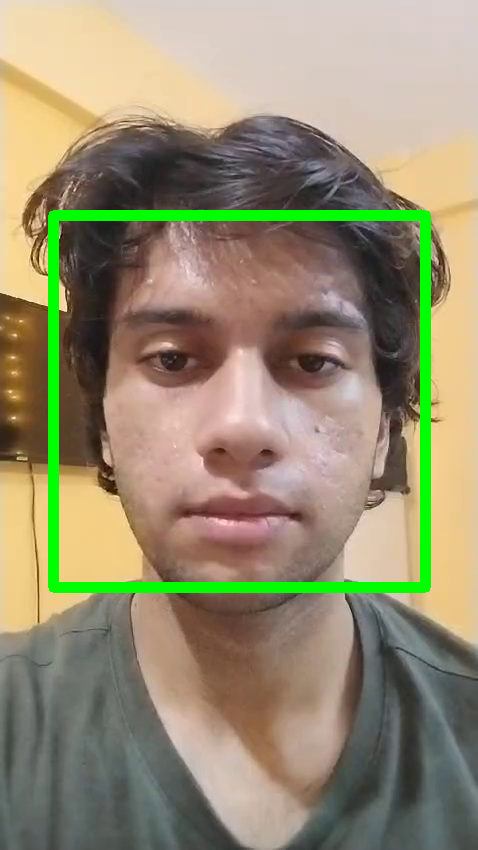

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 31ms/step


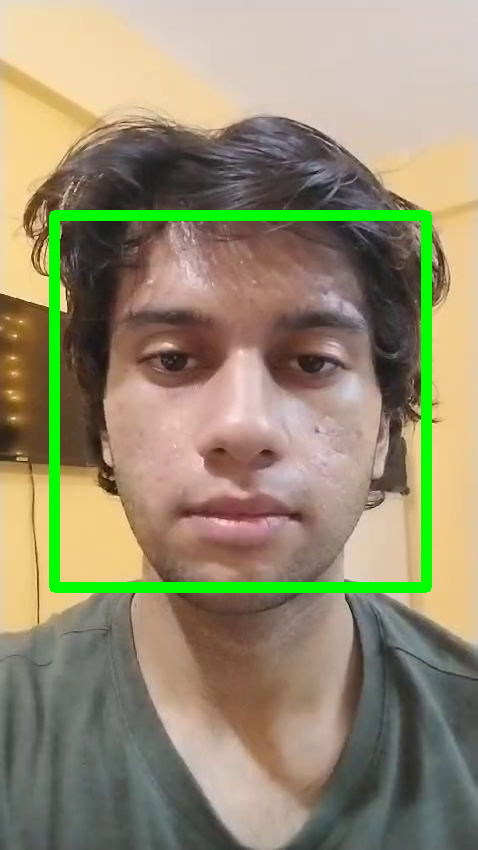

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 26ms/step


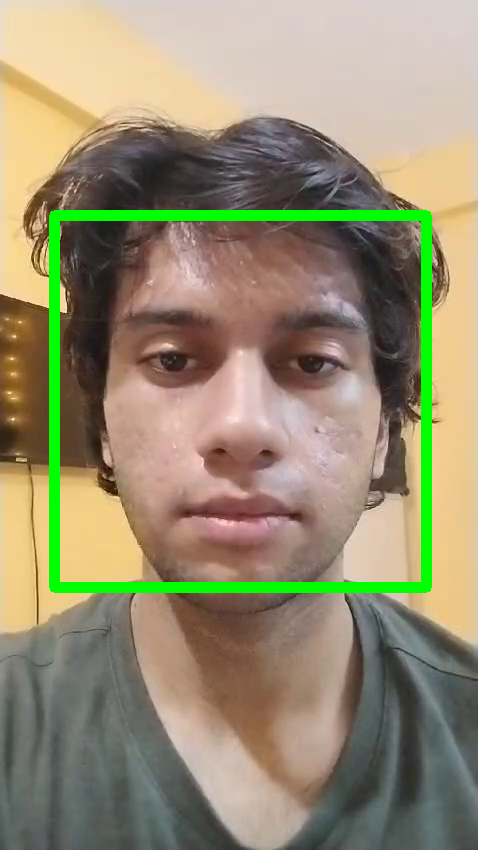

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 39ms/step


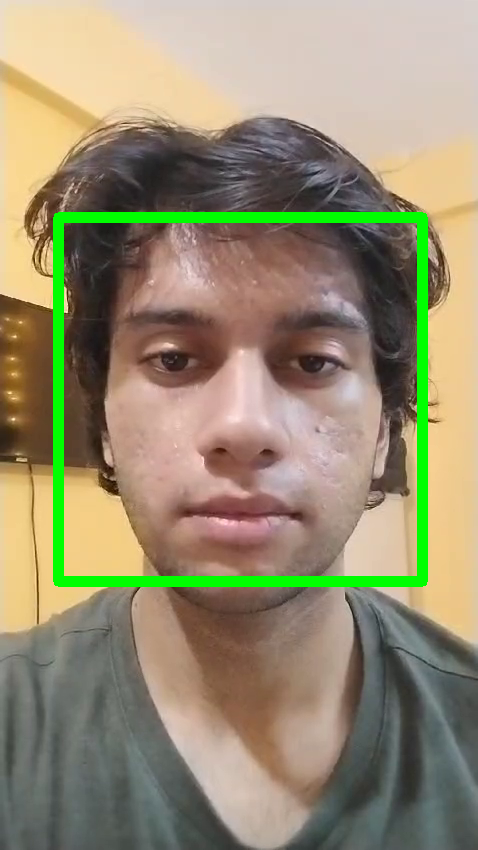

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 26ms/step


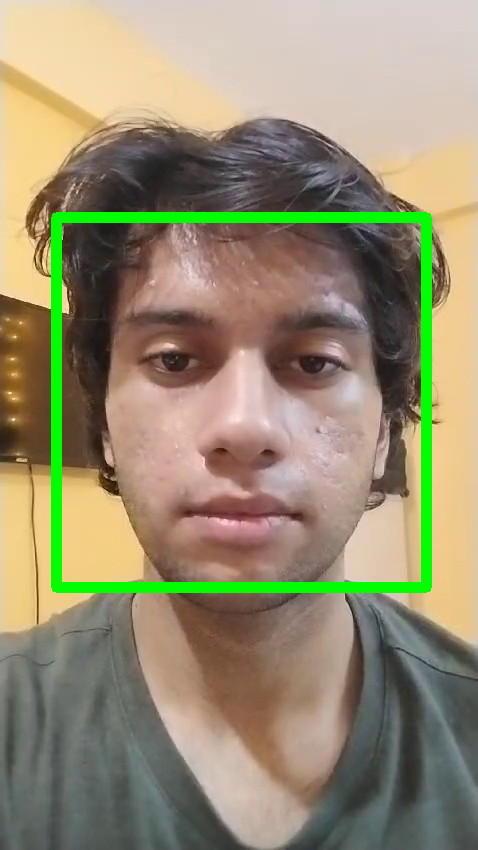

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 27ms/step


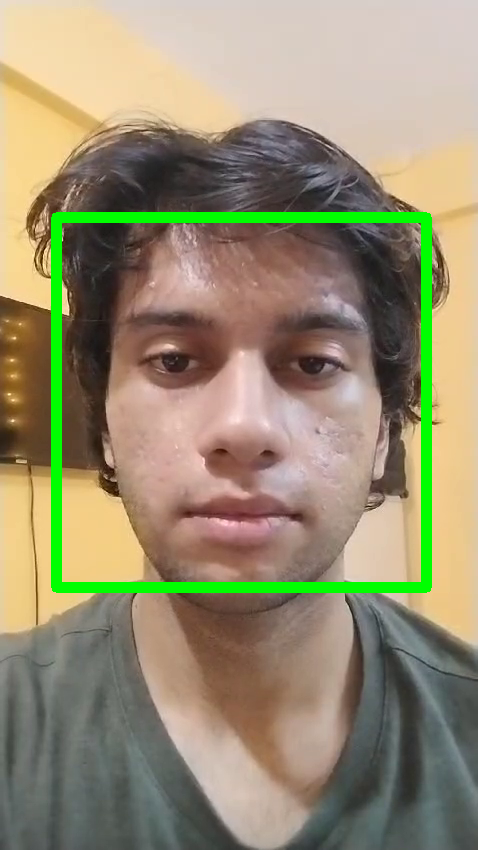

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 26ms/step


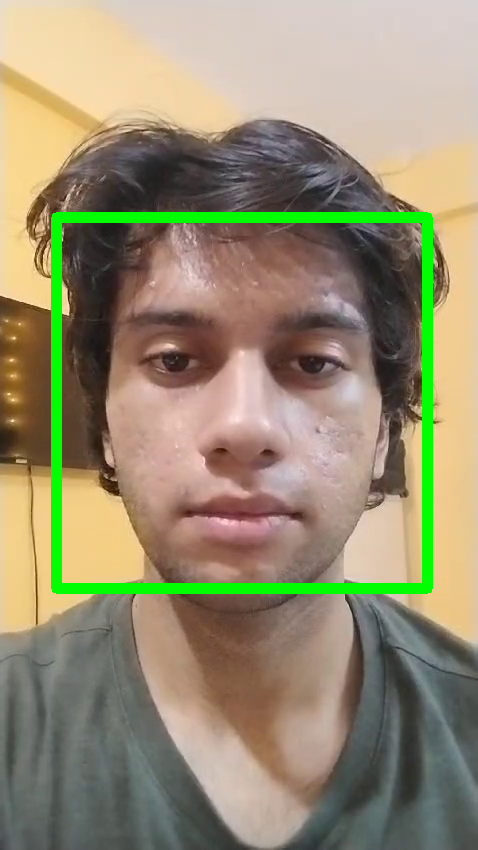

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 27ms/step


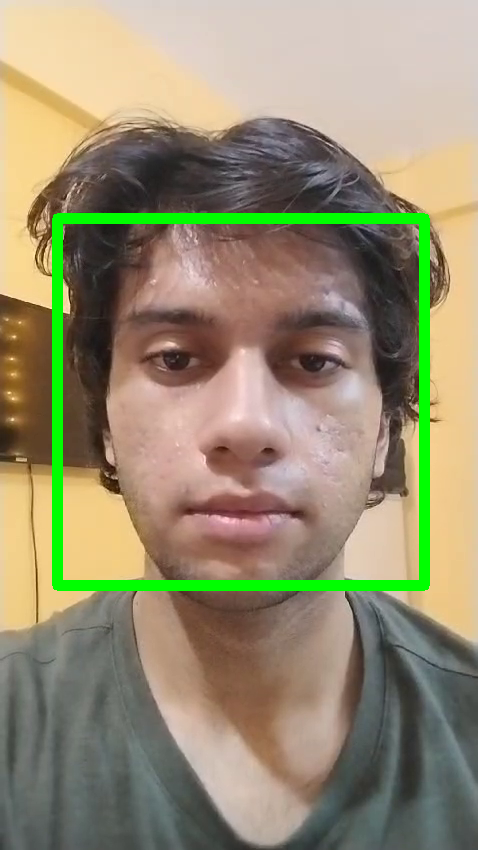

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 39ms/step


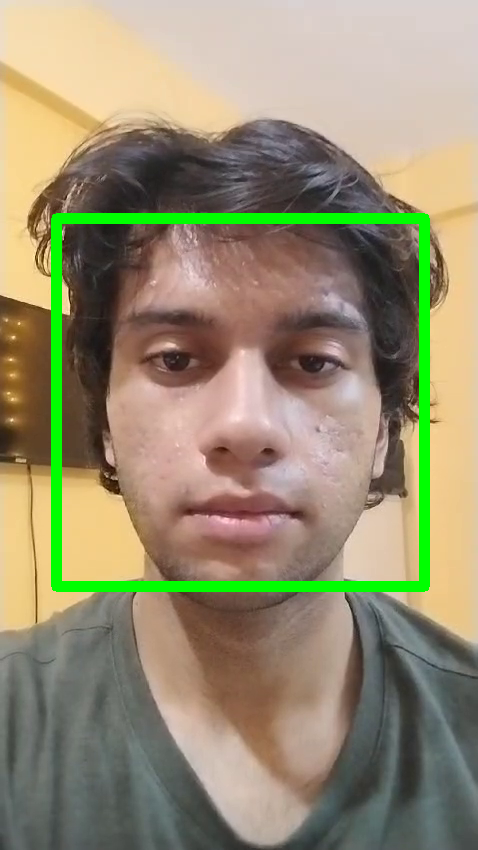

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 61ms/step


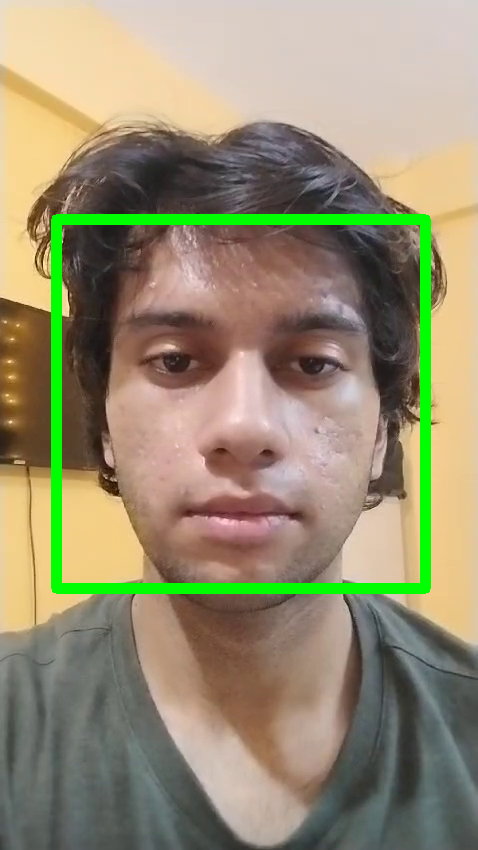

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 37ms/step


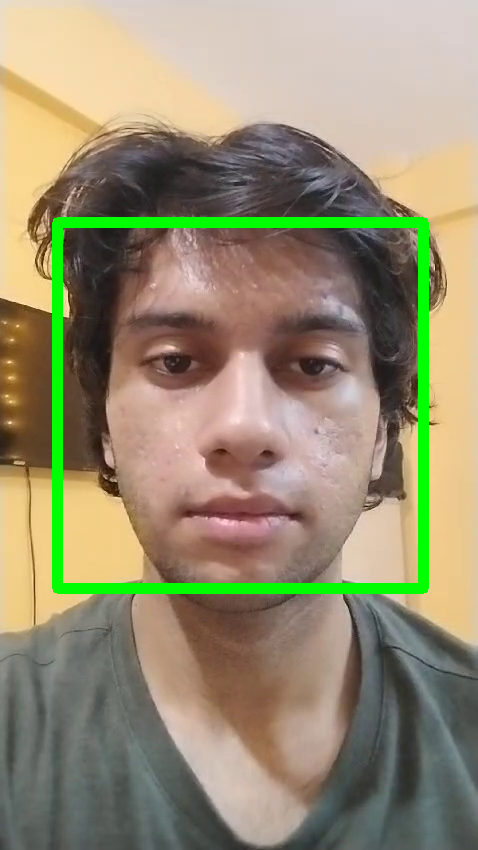

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 63ms/step


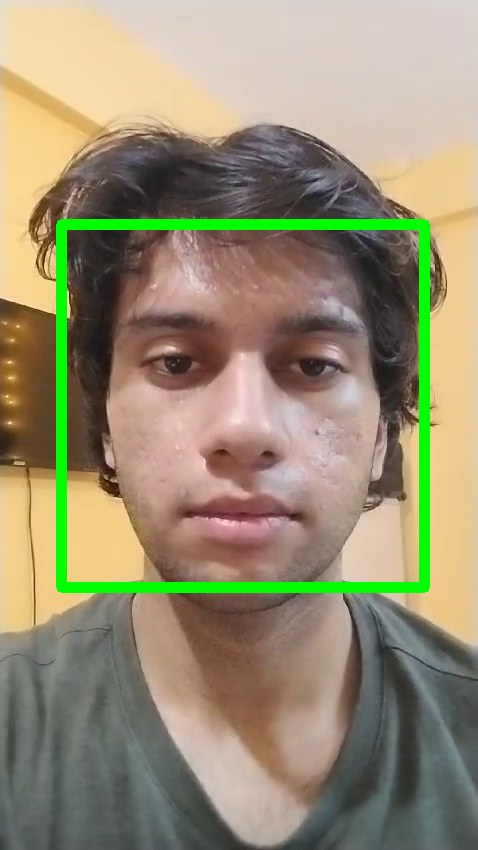

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 37ms/step


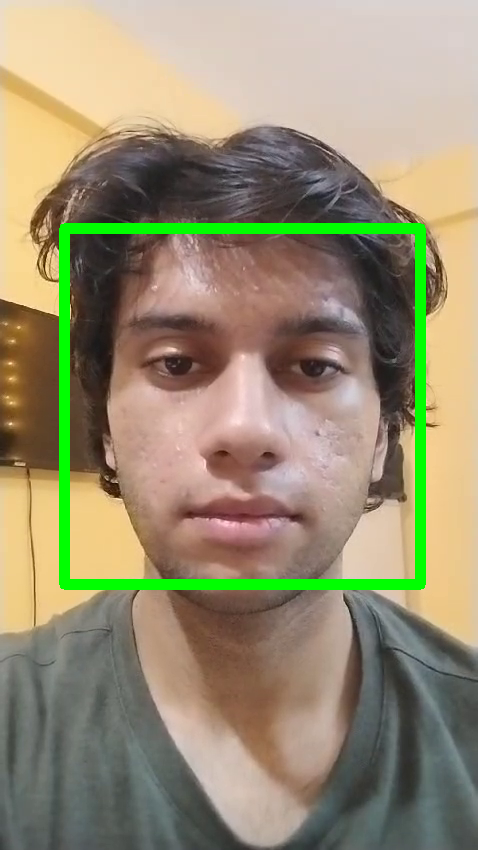

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 38ms/step


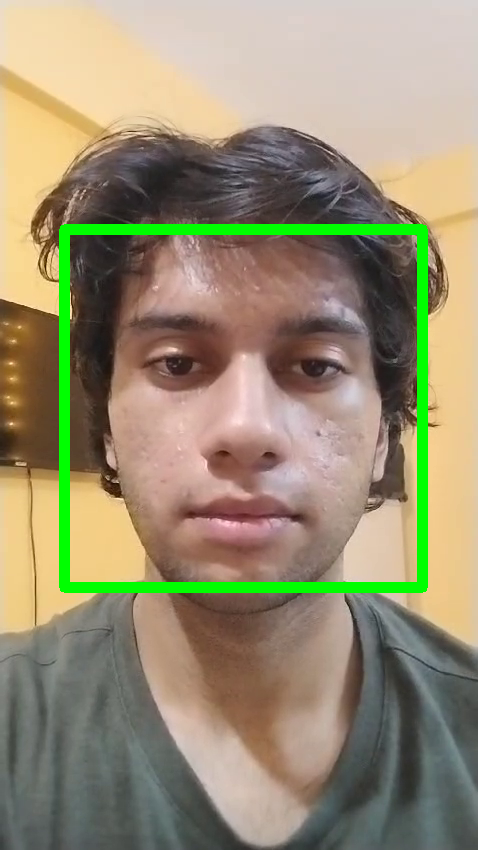

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 39ms/step


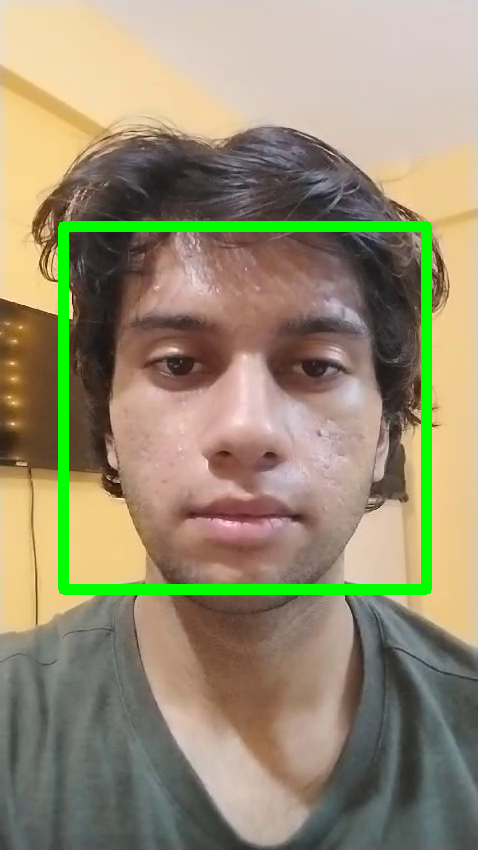

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 25ms/step


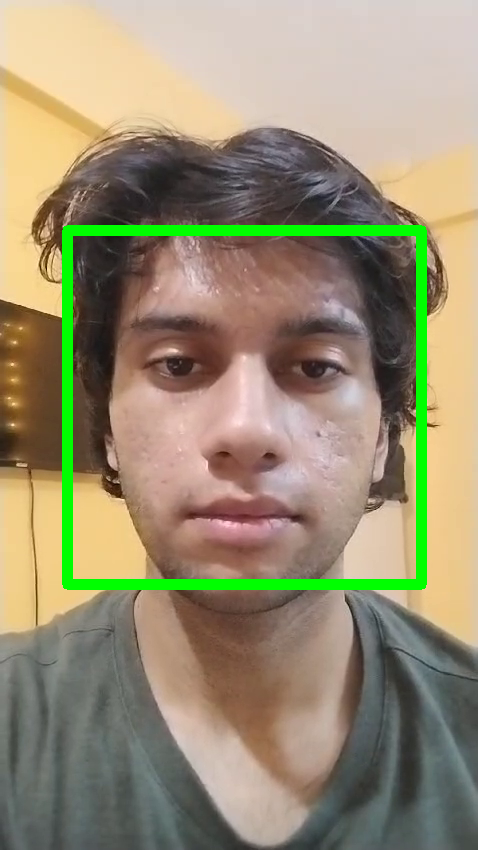

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 26ms/step


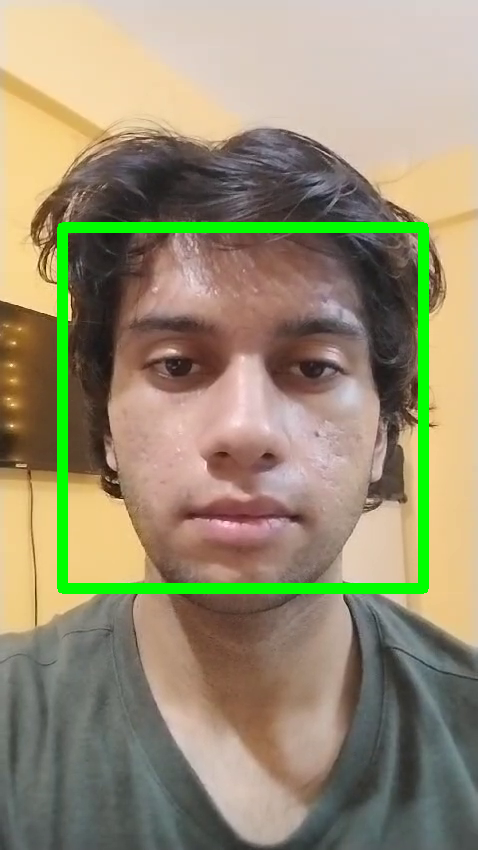

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 33ms/step


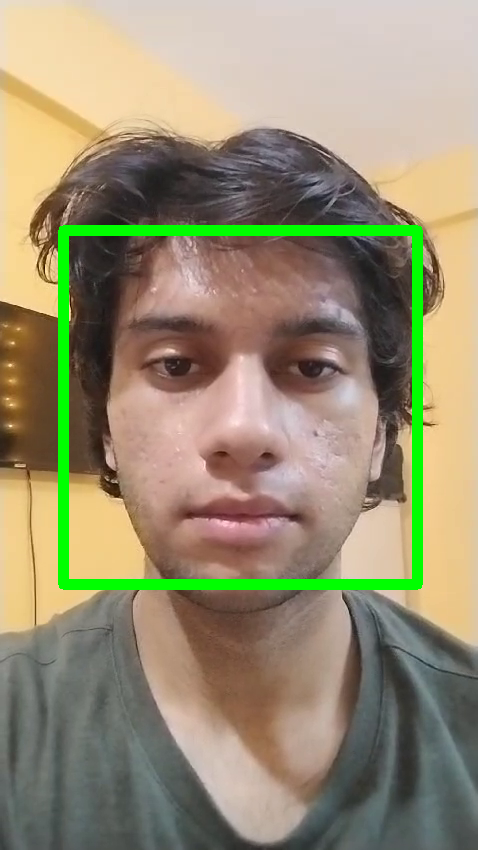

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 33ms/step


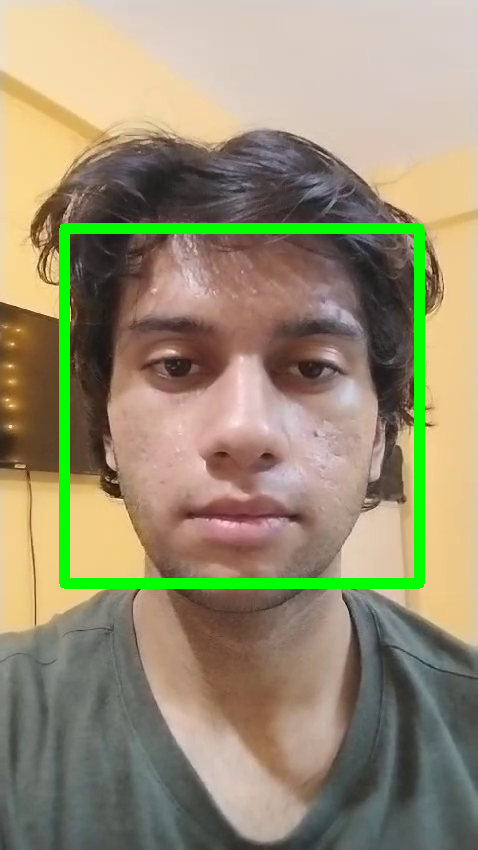

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 25ms/step


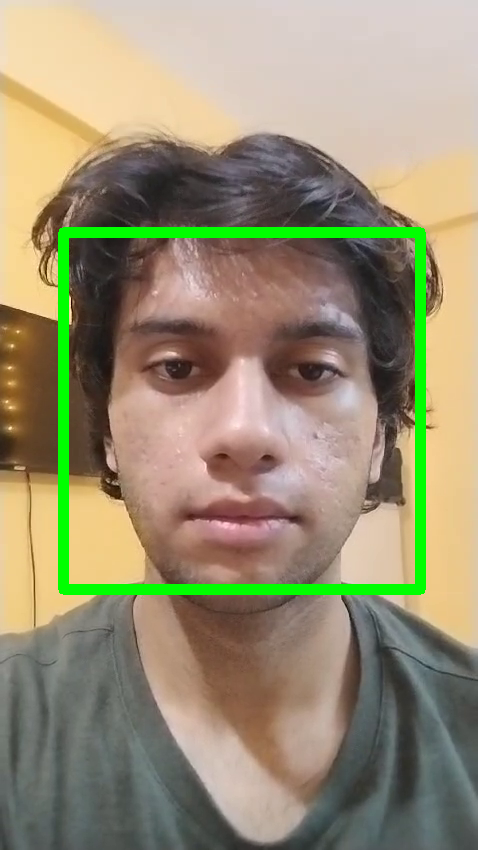

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 26ms/step


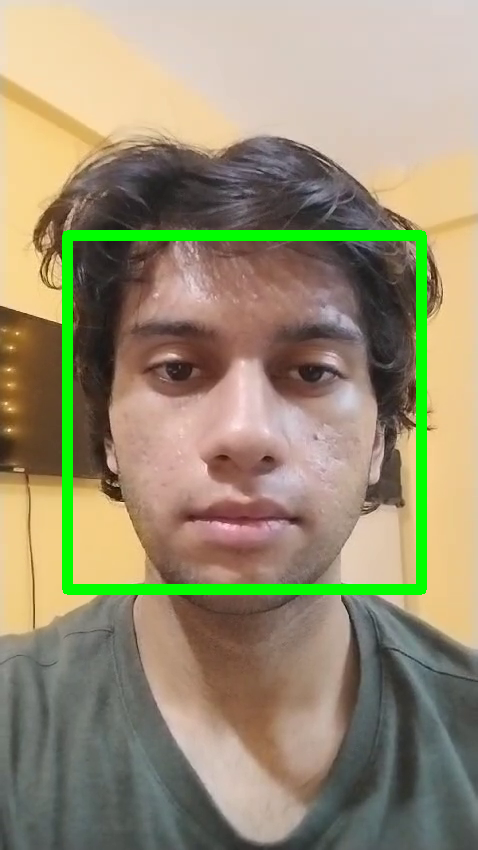

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 25ms/step


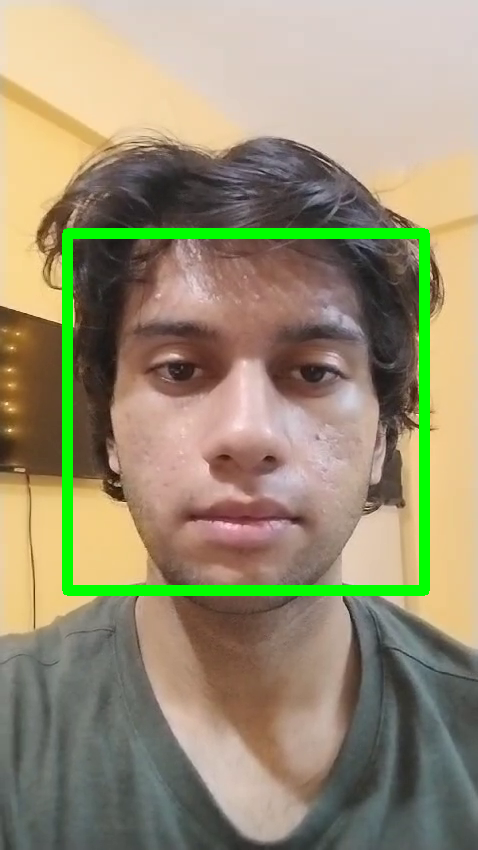

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 26ms/step


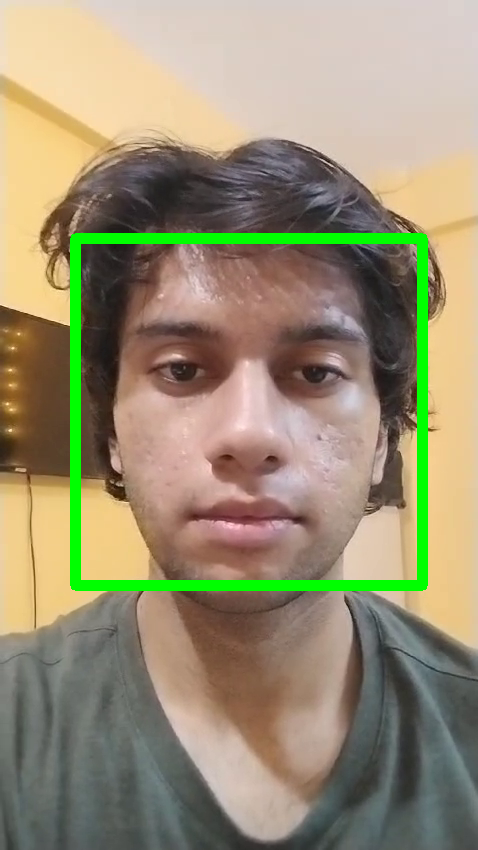

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 27ms/step


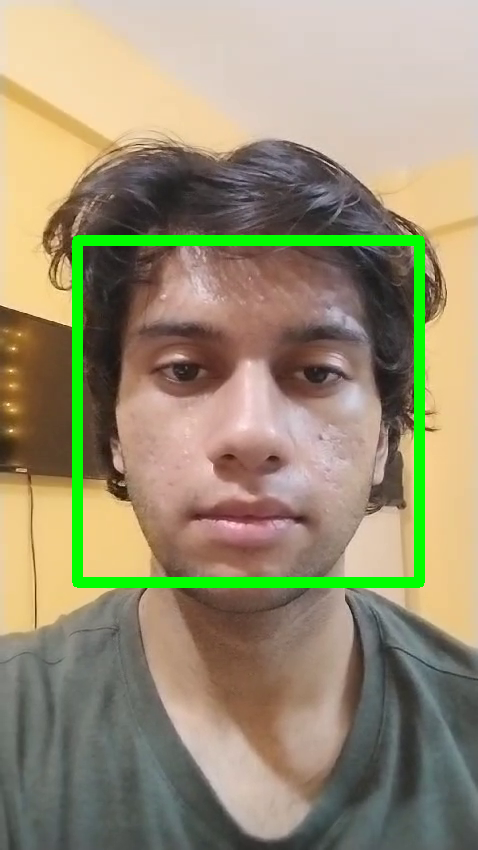

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 30ms/step


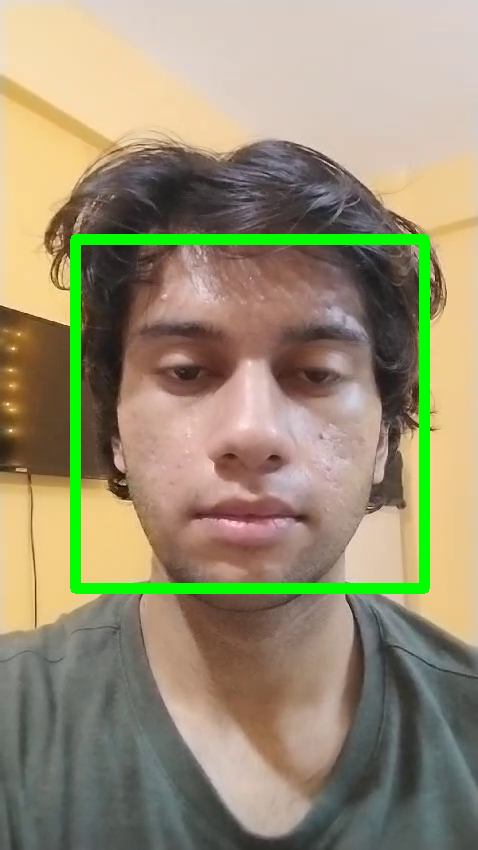

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 25ms/step


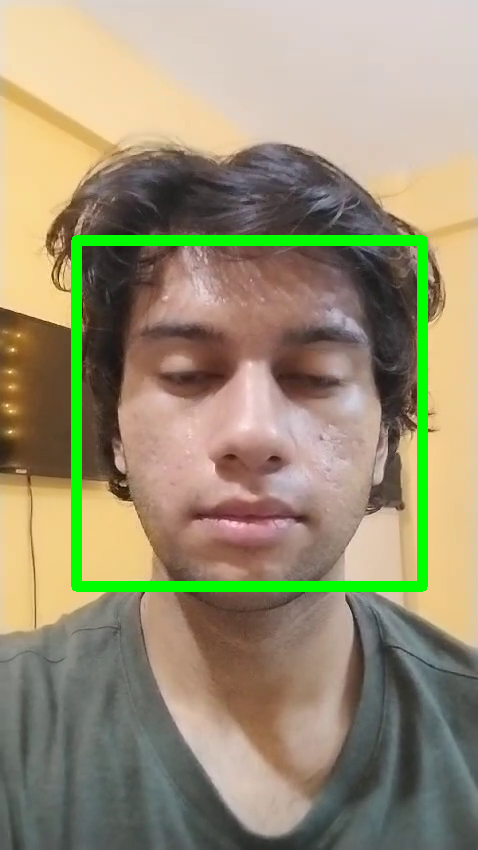

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 25ms/step


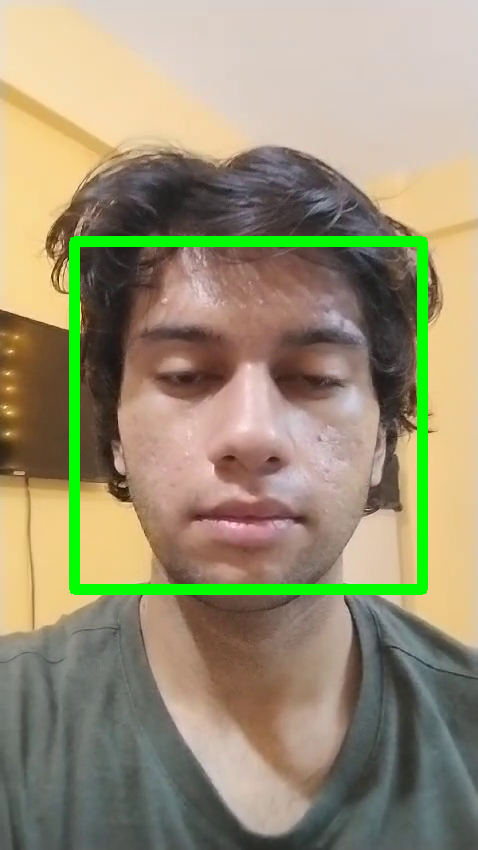

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 35ms/step


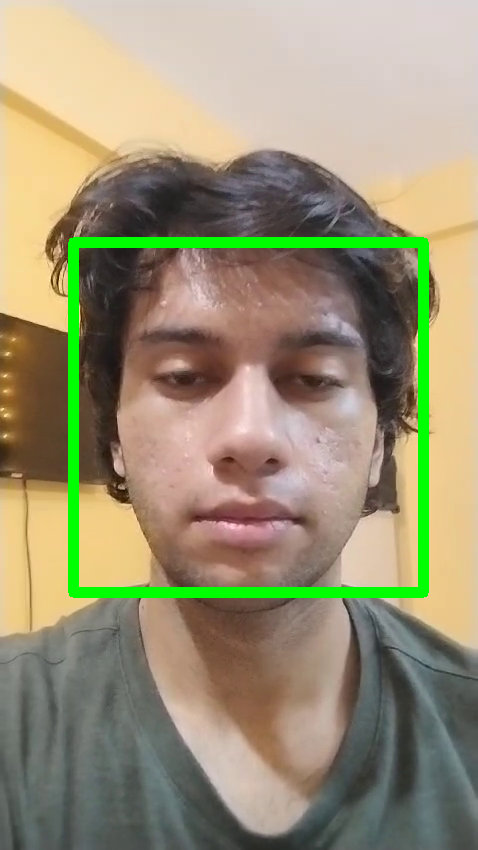

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 27ms/step


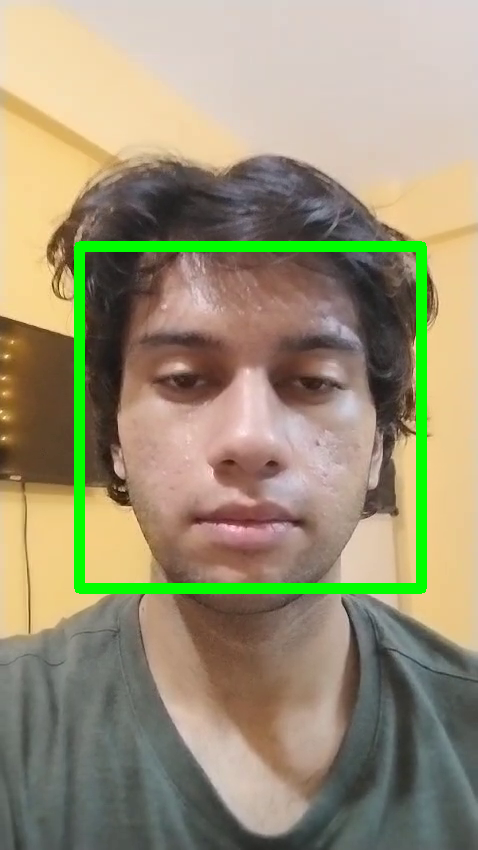

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 26ms/step


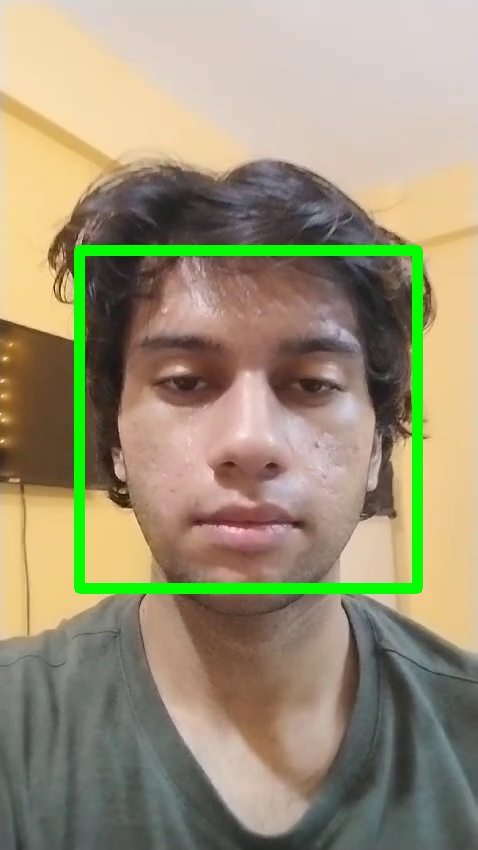

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 25ms/step


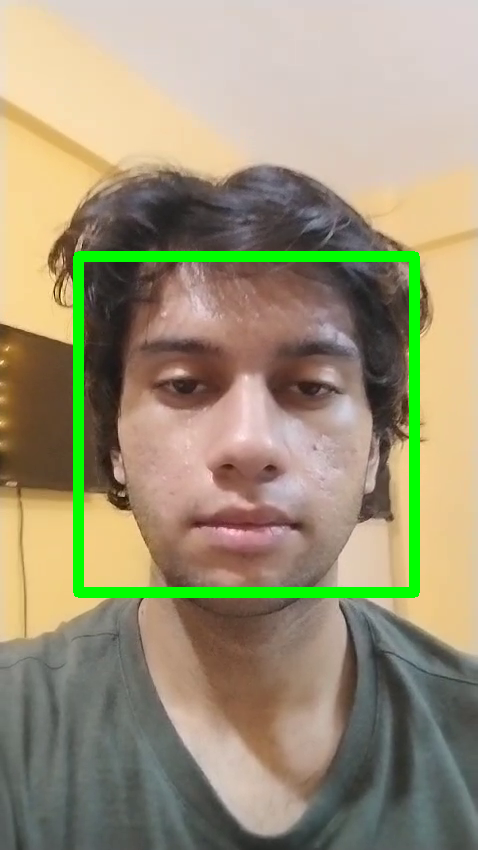

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 26ms/step


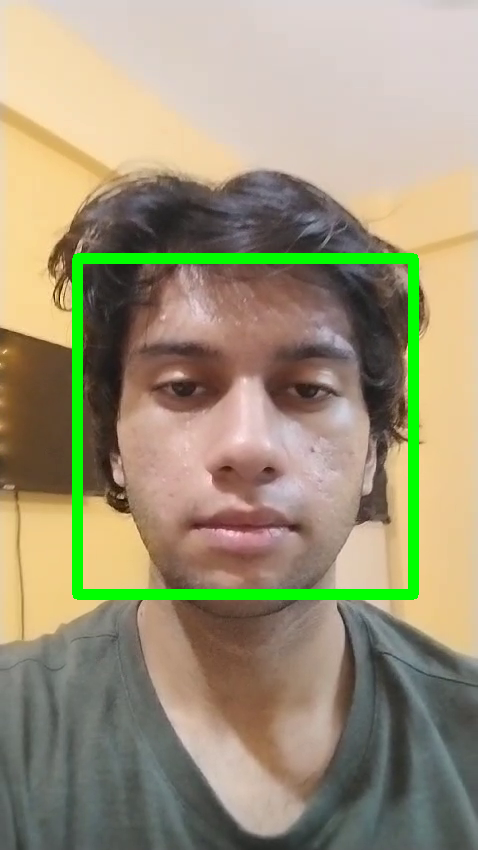

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 26ms/step


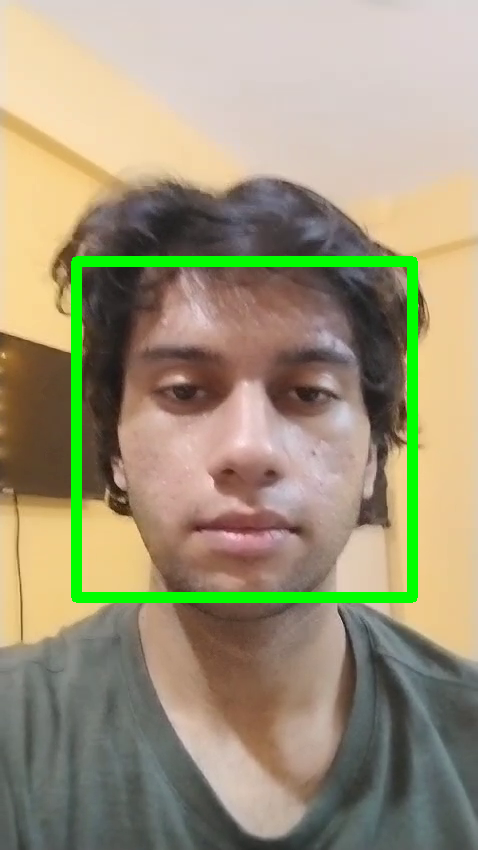

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 27ms/step


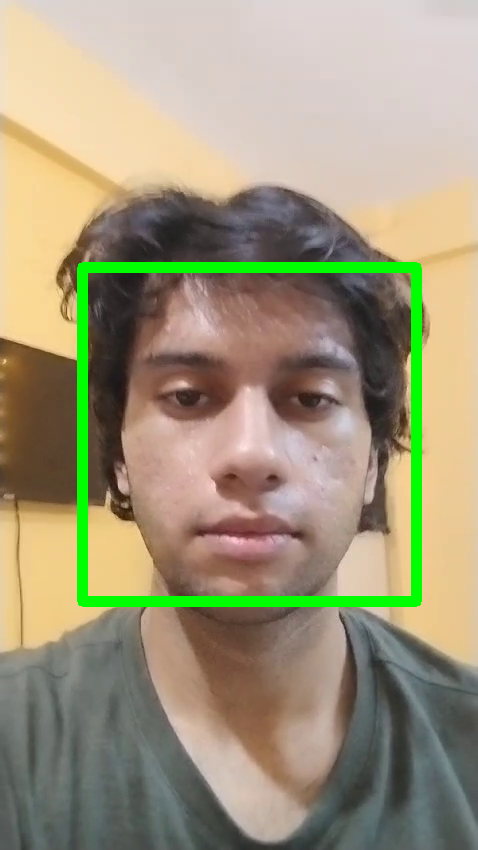

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 34ms/step


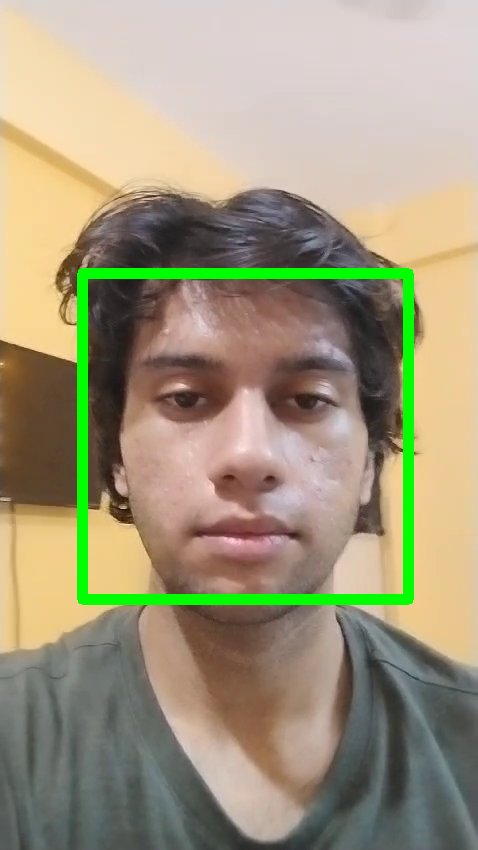

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 26ms/step


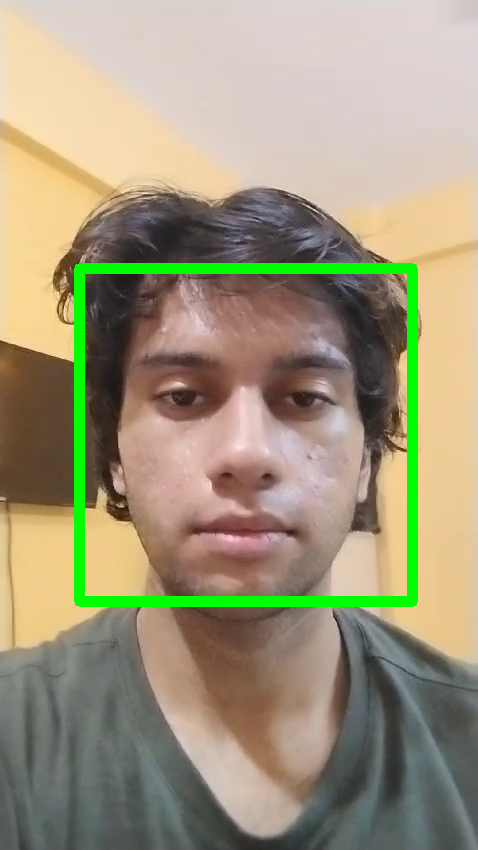

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 39ms/step


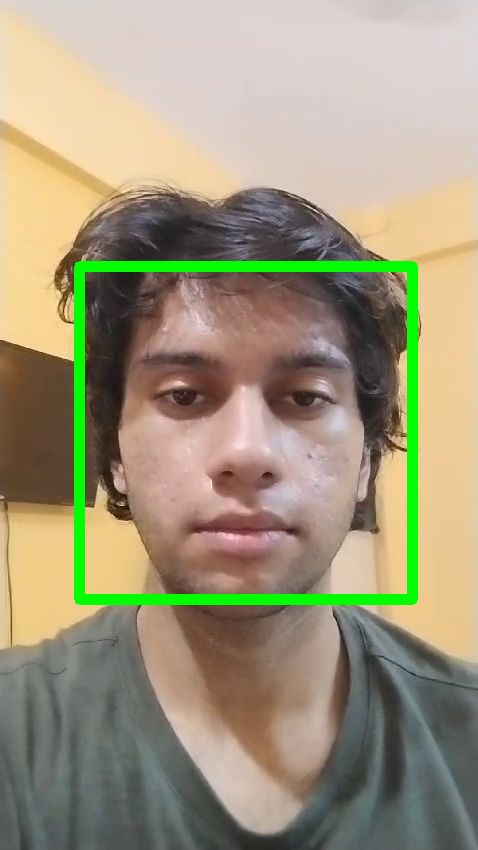

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 25ms/step


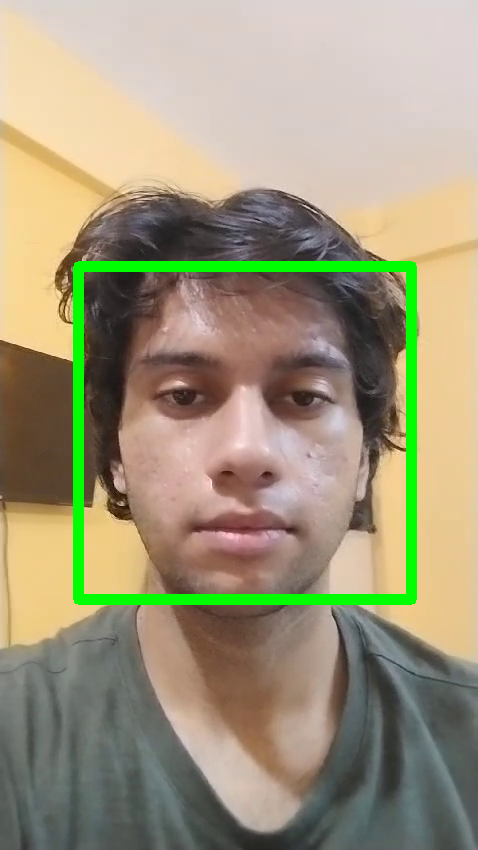

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 43ms/step


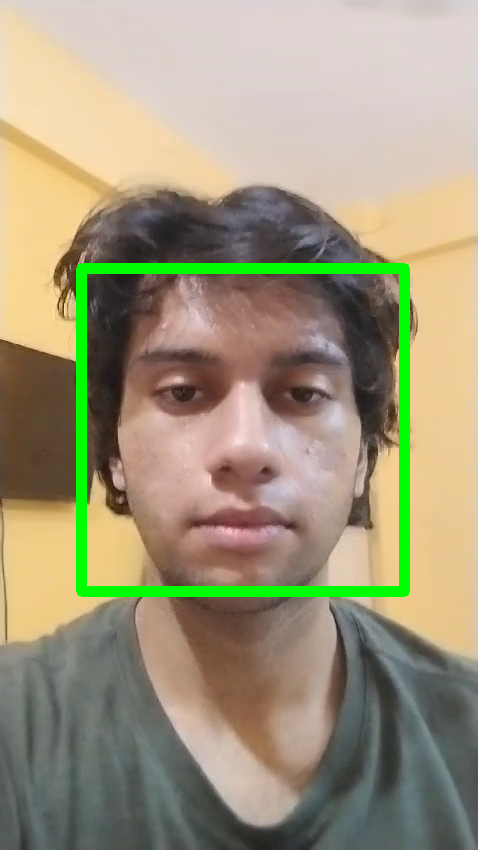

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 66ms/step


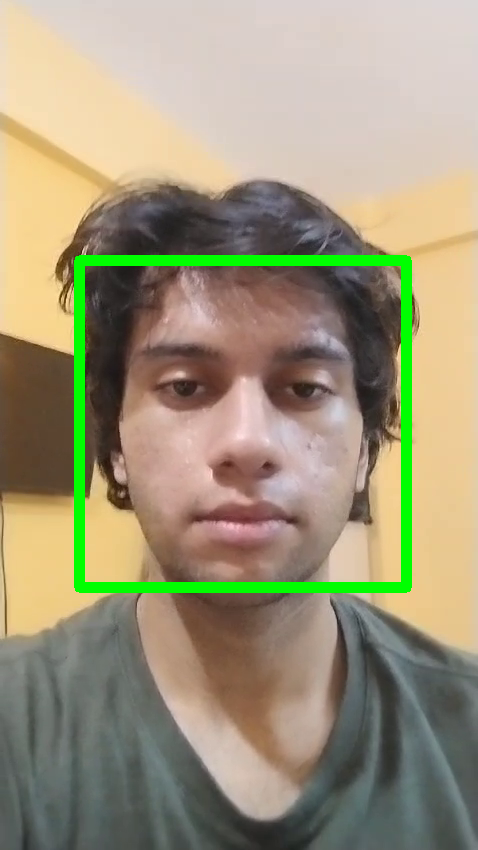

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 51ms/step


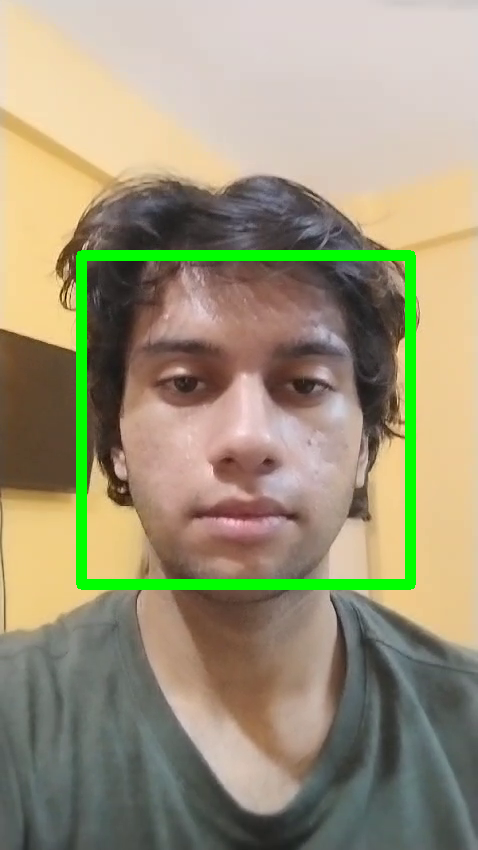

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 55ms/step


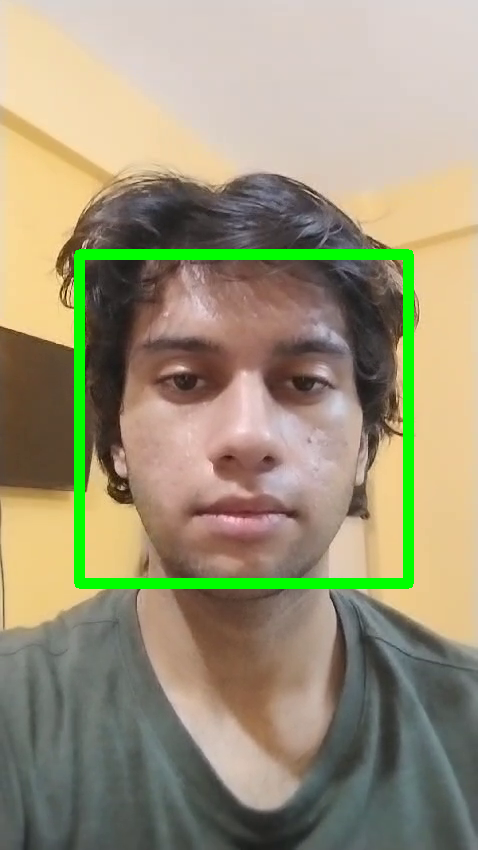

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 41ms/step


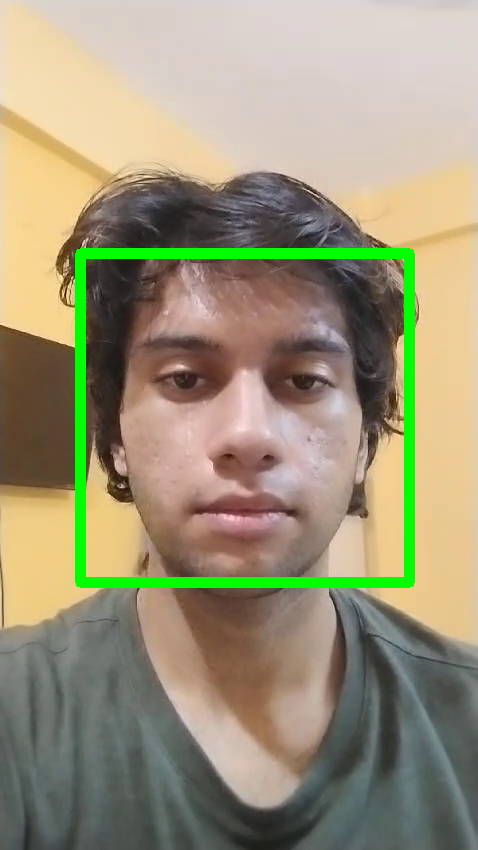

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 49ms/step


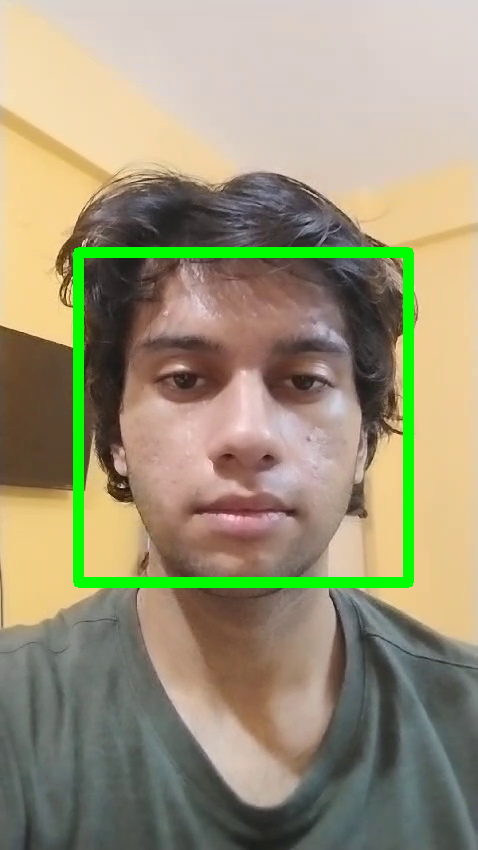

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 33ms/step


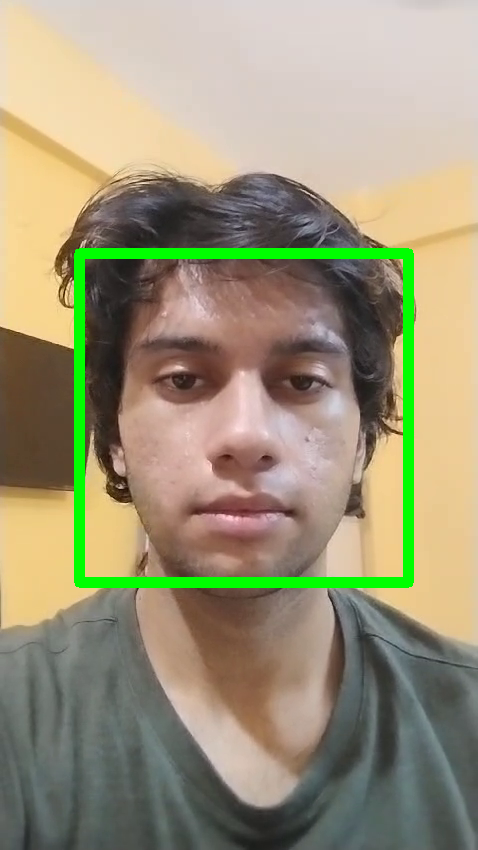

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 54ms/step


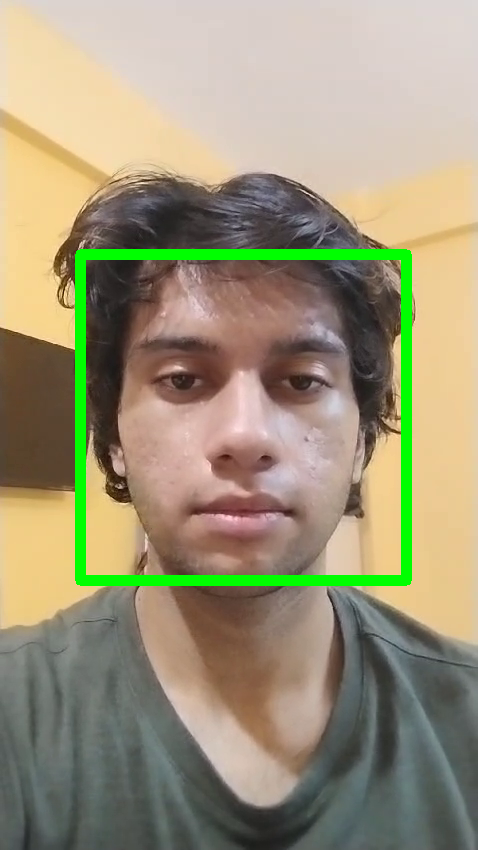

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 45ms/step


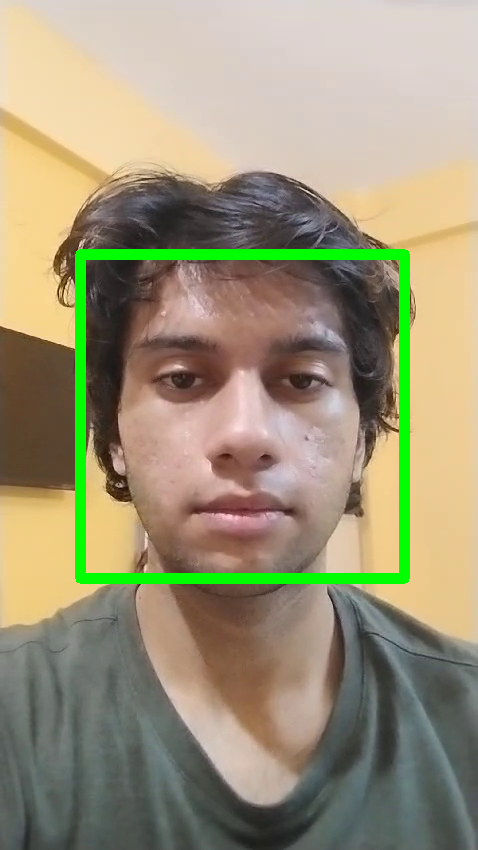

yes
<class 'numpy.ndarray'>
1/1 [==============================] - 0s 64ms/step


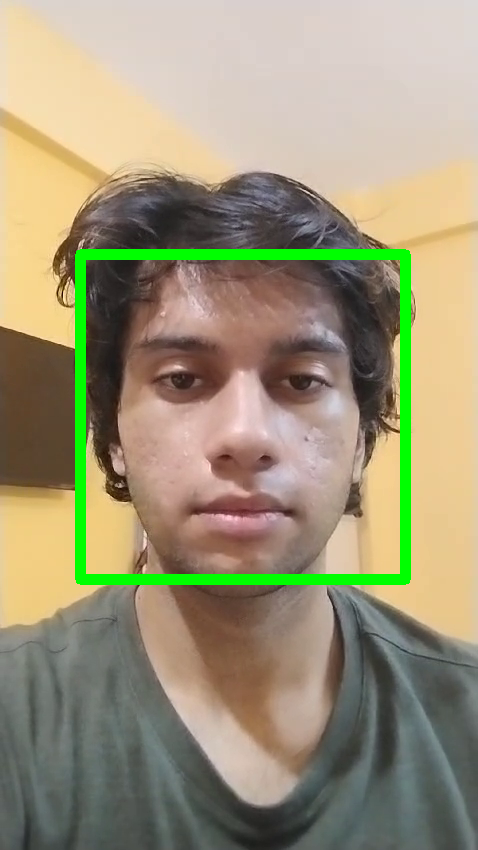

yes
<class 'numpy.ndarray'>


KeyboardInterrupt: 

In [ ]:
from google.colab.patches import cv2_imshow
cap = cv2.VideoCapture('/content/testvid3.mp4')
if cap.isOpened() == False:
    print("Error opening video stream or file")

while cap.isOpened():


    ret, frame = cap.read()

    if ret == True:
        print('yes')
        print(type(frame))


        frame = detect_face(frame)

        cv2_imshow(frame)

        c = cv2.waitKey(1)
        if c == 27:
            break

cap.release()
cv2.destroyAllWindows()